# Camera


## 1. Autonomous Vehicles and Computer Vision

### a) Autonomous Vehicle Sensor Sets

#### [The Uber ATG Autonomous Vehicle](https://eng.uber.com/atg-dataviz/)

The current version of the Uber autonomous vehicle combines a top-mounted 360° Lidar scanner with several cameras and radar sensors placed around the car circumference.

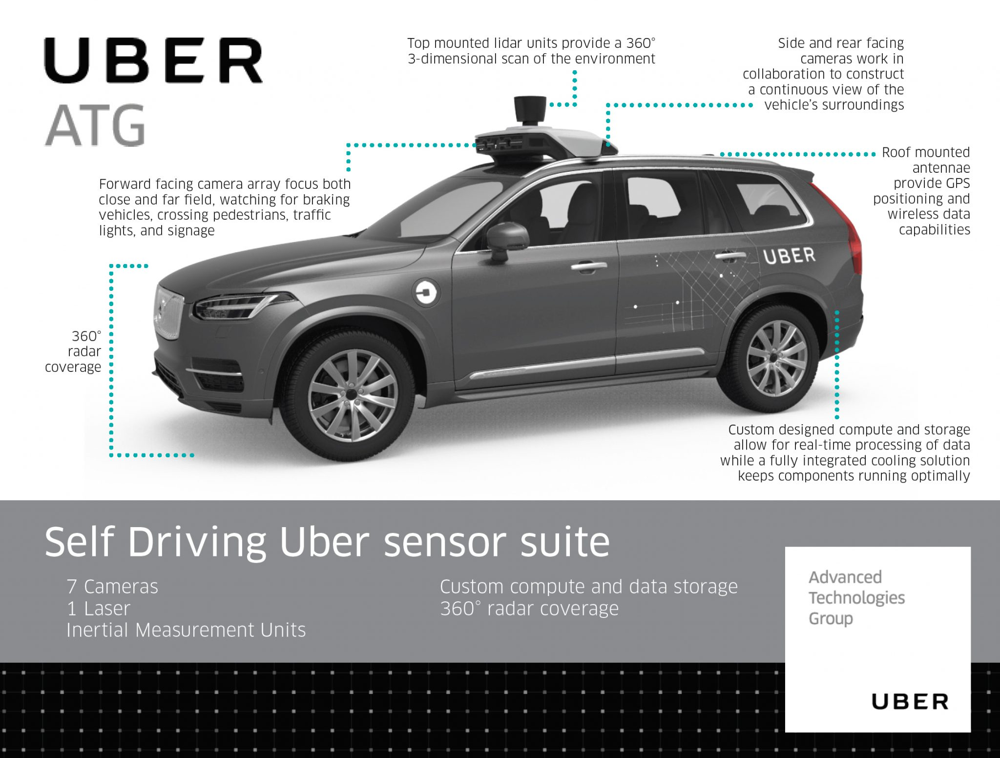

Let us take a look at those sensor classes one-by one:

1. ***Cameras***: Ubers fleet of modified Volvo XC90 SUVs features a range of cameras on their roofs, plus additional cameras that point to the sides and behind the car. The roof cameras are able to focus both close and far field, watch for braking vehicles, crossing pedestrians, traffic lights, and signage. The cameras feed their material to a central on-board computer, which also receives the signals of the other sensors to create a precise image of the vehicle’s surroundings. Much like human eyes, the performance of camera systems at night is strongly reduced, which makes them less reliable to locate objects with the required detection rates and positional accuracy. This is why the Uber fleet is equipped with two additional sensor types.

2. ***Radar***: Radar systems emit radio waves which are reflected off of (many but not all) objects. The returning waves can be analyzed with regard to their runtime (which gives distance) as well as their shifted frequency (which gives relative speed). The latter property clearly distinguished the radar from the other two sensor types as it is the only one who is able to directly measure the speed of objects. Also, radar is very robust against adverse weather conditions like heavy snow and thick fog. Used by cruise control systems for many years, radar works best when identifying larger objects with good reflective properties. When it comes to detecting smaller or „soft“ objects (humans, animals) with reduced reflective properties, the radar detection performance drops. Even though camera and radar combine well, there are situations where both sensors do not work optimally - which is why Uber chose to throw a third sensor into the mix.

3. ***Lidar***: Lidar works in a similar way to radar, but instead of emitting radio waves it uses infrared light. The roof-mouted sensor rotates at a high velocity and builds a detailed 3D image of its surroundings. In case of the Velodyne VLS-128, a total of 128 laser beams is used to detect obstacles up to a distance of 300 meters. During a single spin through 360 degrees, a total of up to 4 million datapoints per second is generated. Similar to the camera, Lidar is an optical sensor. It has the significant advantage however of "bringing its own light source“, whereas cameras are dependent on ambient light and the vehicle headlights. It has to be noted however, that Lidar performance is also reduced in adverse environmental conditions such as snow, heavy rain or fog. Coupled with low reflective properties of certain materials, a Lidar might thus fail at generating a sufficiently dense point cloud for some objects in traffic, leaving only a few 3D points with which to work. It is thus a good idea to combine Lidar with other sensors to ensure that detection performance is sufficiently hight for autonomous navigation through traffic.

The following scene shows the Lidar 3D point cloud generated by the Uber autonomous vehicle as well as the image of the front camera as an overlay in the top-left corner. The overall impression of the reconstructed scene is very positive. If you look closely however, you can observe that the number of Lidar points varies greatly between the objects in the scene.

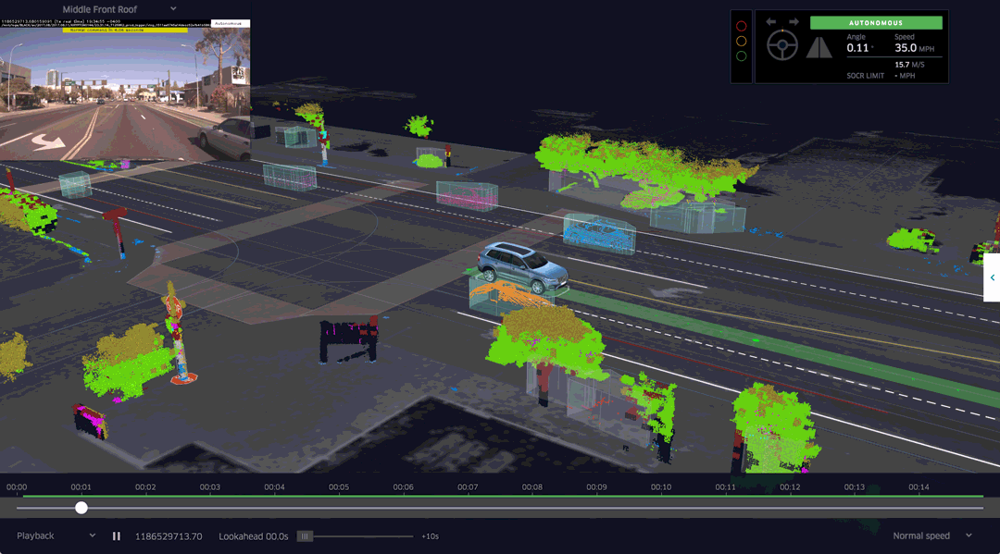

#### [Mercedes Benz Autonomous Prototype](https://www.mercedes-benz.com/en/mercedes-benz/innovation/successful-autonomous-driving-a-pilot-project-by-daimler-and-bosch/)

Currently, German car maker Mercedes Benz is developing an autonomous vehicle prototype that is equipped with cameras, Lidar and radar sensors, similar to the Uber vehicle. Mercedes uses several cameras to scan the area around the vehicle. Of special interest is a stereo setup consisting of two synchronized cameras, which is able to measure depth by finding corresponding features in both images. The picture below shows the entire host of cameras used by the system. Mercedes states that the stereo camera alone generates a total of 100 gigabytes of data for every kilometer driven.

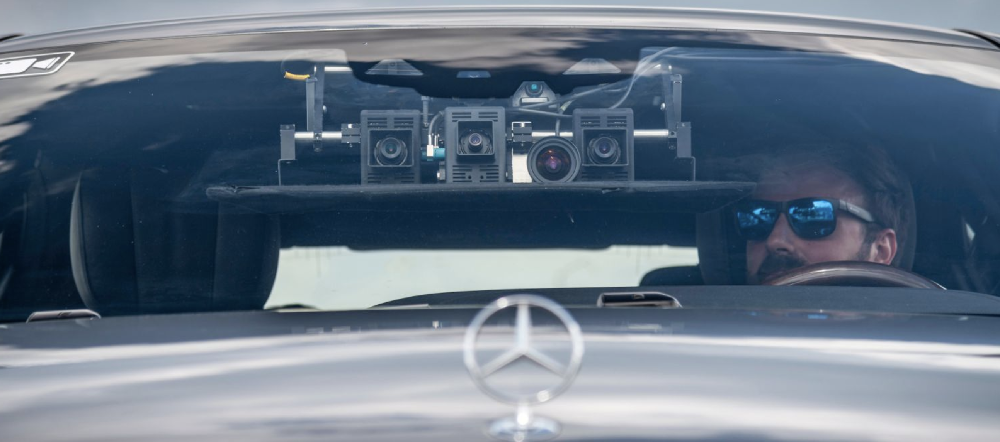

#### [The Tesla Autopilot](https://www.tesla.com/de_DE/autopilot)

When the Autopilot system was first sold, it basically was a combination of adaptive cruise control and lane change assist - a set of functions which had long been available with other manufacturers around the globe. The name „Autopilot“ implied however, that the car would be truly autonomous. And indeed did many Tesla owners test the system to its limits by climbing onto the back seat , reading a book or taking a nap while being driven by the system. On the SAE scale however, the Autopilot can „only“ be classified as level 2, i.e. the driver is responsible for the driving task at all times.

In October 2016, the Tesla Model S and X sensor set was significantly upgraded and the capabilities of the Autopilot were extended by regular airborne software updates.

The image shows the interior of a Tesla with the camera views superimposed on the right side. The image shows left and right rear-facing cameras as well as a forward-facing camera for medium-range perception.

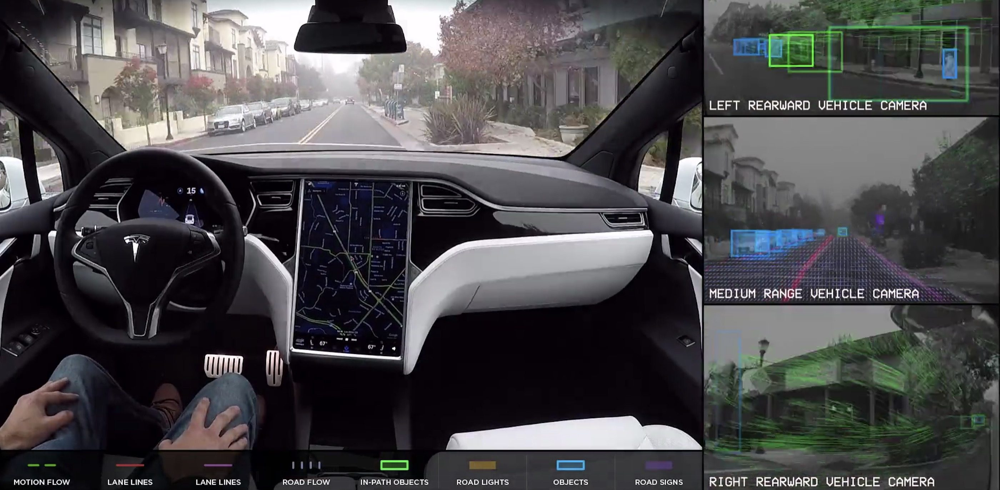

As can be seen in the overview, the system combines several camera sensors with partially overlapping fields of view with a forward-facing radar sensor.

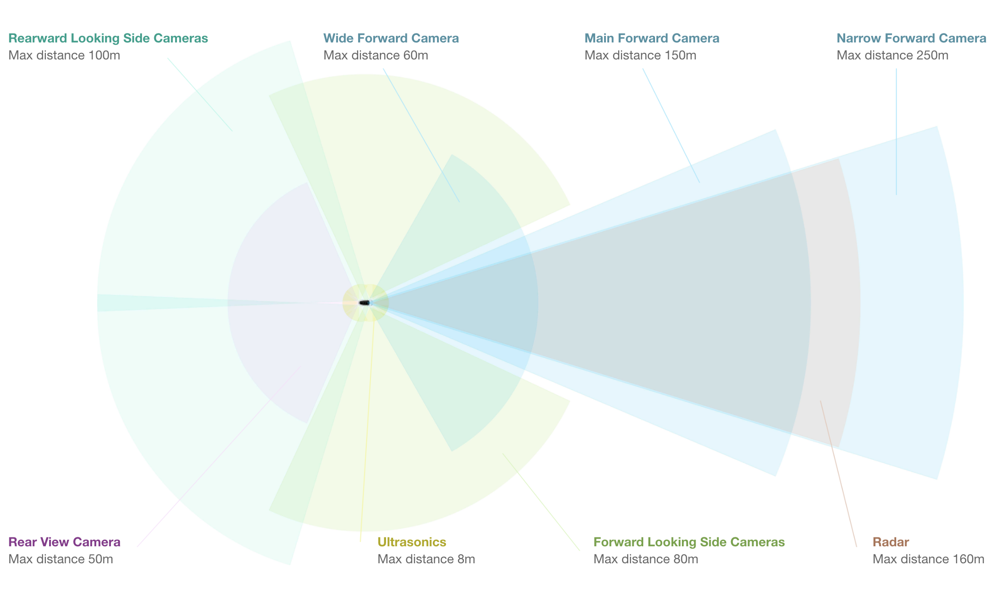

Let us look at each sensor type in turn:

1. ***Cameras*** : The forward-facing optical array consists of four cameras with differing focal lengths. The narrow-forward camera captures footage up until 250m in front, the forward camera with a slightly larger opening angle looks up until 150m in front, a wide-angle camera that captures 60m in front, and a set of forward-looking side cameras that capture footage 80m in front and to the side of the car. The wide-angle camera is designed to read road signs and traffic lights, allowing the car to react accordingly. It is debated however, wether this feature can be reliably used in traffic.

2. ***Radar*** : The forward-looking radar can see up to 160m ahead of the car. According to Tesla founder Elon Musk it is able to see through "sand, snow, fog—almost anything".

3. ***Sonar*** : A 360° ultrasonic sonar detects obstacles in an eight-meter radius around the car. The ultrasonic sensors work at any speed and are used to spot objects in close proximity of the car. The ultrasonic sensors can also be used to assist the car when automatically switching lanes. Their range however, compared to the other sensors of the set, is significantly limited and ends at about 8 meters distance.

As you may have noticed, Tesla is not using a Lidar sensor despite its plans to offer level 4 or even level 5 autonomous driving with this setup. Unlike many other manufacturers who aim at full autonomy such as Uber, Waymo and several others, Tesla is convinced that a set of high-performance cameras coupled with a powerful radar sensor will be sufficient for level 4 / level 5 autonomy. At the time of writing, there is a fierce debate going on about the best sensor set of autonomous vehicles. Tesla argues that the price and packaging disadvantage of Lidar would make the Autopilot unattractive to customers. Harsh critics such as GM's director of autonomous vehicle integration Scott Miller disagrees and argues with the highly elevated safety requirements of autonomous vehicles, which would not be met with cameras and radar alone.

Is has to be noted however that in all sensor setups, be it Uber, Tesla, Waymo or traditional manufacturers such as Mercedes or Audi, cameras are always used. Even though there is an ongoing debate on wether radar or Lidar or a combination of the two would be best, cameras are never in question. It is therefore a good idea to learn about cameras and computer vision, which we will do in great detail in this course.

### b) Sensor Selection Criteria
The design of an autonomous or ADAS-equipped vehicle involves the selection of a suitable sensor set. As you have learned in the preceding section, there is a discussion going on about which combination of sensors would be necessary to reach full (or even partial) autonomy. In this section, you will learn about sensor selection criteria as well as the differences between camera, Lidar and radar with respect to each criterion.

In the following, the most typical selection criteria are briefly discussed.

1. Range : Lidar and radar systems can detect objects at distances ranging from a few meters to more than 200m. Many Lidar systems have difficulties detecting objects at very close distances, whereas radar can detect objects from less than a meter, depending on the system type (either long, mid or short range) . Mono cameras are not able to reliably measure metric distance to object - this is only possible by making some assumptions about the nature of the world (e.g. planar road surface). Stereo cameras on the other hand can measure distance, but only up to a distance of approx. 80m with accuracy deteriorating significantly from there.

2. Spatial resolution : Lidar scans have a spatial resolution in the order of 0.1° due to the short wavelength of the emitted IR laser light . This allows for high-resolution 3D scans and thus characterization of objects in a scene. Radar on the other hand can not resolve small features very well, especially as distances increase. The spatial resolution of camera systems is defined by the optics, by the pixel size on the image and by its signal-to-noise ratio. Details on small object are lost as soon as the light rays emanating from them are spread to several pixels on the image sensor (blurring). Also, when little ambient light exists to illuminate objects, spatial resolution increases as objects details are superimposed by increasing noise levels of the imager.

3. Robustness in darkness : Both radar and Lidar have an excellent robustness in darkness, as they are both active sensors. While daytime performance of Lidar systems is very good, they have an even better performance at night because there is no ambient sunlight that might interfere with the detection of IR laser reflections. Cameras on the other hand have a very reduced detection capability at night, as they are passive sensors that rely on ambient light. Even though there have been advances in night time performance of image sensors, they have the lowest performance among the three sensor types.

4. Robustness in rain, snow, fog : One of the biggest benefits of radar sensors is their performance under adverse weather conditions. They are not significantly affected by snow, heavy rain or any other obstruction in the air such as fog or sand particles. As an optical system, Lidar and camera are susceptible to adverse weather and its performance usually degrades significantly with increasing levels of adversity.

5. Classification of objects : Cameras excel at classifying objects such as vehicles, pedestrians, speed signs and many others. This is one of the prime advantage of camera systems and recent advances in AI emphasize this even stronger. Lidar scans with their high-density 3D point clouds also allow for a certain level of classification, albeit with less object diversity than cameras. Radar systems do not allow for much object classification.

6. Perceiving 2D structures : Camera systems are the only sensor able to interpret two-dimensional information such as speed signs, lane markings or traffic lights, as they are able to measure both color and light intensity. This is the primary advantage of cameras over the other sensor types.

7. Measure speed : Radar can directly measure the velocity of objects by exploiting the Doppler frequency shift. This is one of the primary advantages of radar sensors. Lidar can only approximate speed by using successive distance measurements, which makes it less accurate in this regard. Cameras, even though they are not able to measure distance, can measure time to collision by observing the displacement of objects on the image plane. This property will be used later in this course.

8. System cost : Radar systems have been widely used in the automotive industry in recent years with current systems being highly compact and affordable. The same holds for mono cameras, which have a price well below US$100 in most cases. Stereo cameras are more expensive due to the increased hardware cost and the significantly lower number of units in the market. Lidar has gained popularity over the last years, especially in the automotive industry. Due to technological advances, its cost has dropped from more than US$75,000 to below US$5,000. Many experts predict that the cost of a Lidar module might drop to less than US$500 over the next years.

9. Package size : Both radar and mono cameras can be integrated very well into vehicles. Stereo cameras are in some cases bulky, which makes it harder to integrate them behind the windshield as they sometimes may restrict the driver's field of vision. Lidar systems exist in various sizes. The 360° scanning Lidar is typically mounted on top of the roof and is thus very well visible. The industry shift towards much smaller solid-state Lidar systems will dramatically shrink the system size of Lidar sensors in the very near future.

10. Computational requirements : Lidar and radar require little back-end processing. While cameras are a cost-efficient and easily available sensor, they require significant processing to extract useful information from the images, which adds to the overall system cost. 

In the following table, the different sensor types are assessed with regard to the criteria discussed above.

|        | Range measurement | Robustness in darkness | Robustness in rain, snow, or fog | Classification of objects | Perceiving 2D Structures | SPATIAL RESOLUTION | ROBUSTNESS IN DAYLIGHT | Measure speed / TTC | System Cost | COMPUTATIONAL REQUIREMENTS | Package size |
|:------:|:-----------------:|:----------------------:|:--------------------------------:|:-------------------------:|:------------------------:|:------------------:|:----------------------:|:-------------------:|:-----------:|:--------------------------:|:------------:|
| Camera |         -         |            -           |                 -                |             ++            |            ++            |          +         |            +           |          +          |      +      |              -             |       +      |
|  Radar |         ++        |           ++           |                ++                |             -             |             -            |          -         |           ++           |          ++         |      +      |              +             |       +      |
|  Lidar |         +         |           ++           |                 +                |             +             |             -            |         ++         |            +           |          +          |      -      |             ++             |       -      |



## 2. Camera Technology Overview

### a) The Pinhole camera
A very simple camera can be designed by placing a light barrier with a tiny opening (the pinhole) between an object of interest. The light emitted by the object passes through the pinhole and lands on a photosensitive surface which stores the light information as an image. The reason why the pinhole has been made so small is to avoid image blurring due to superimposing rays of light stemming from various parts of the object of interest.

This simple principle has been well known for centuries and was for example used by artists to create photorealistic portraits.

![Leonardo da Vinci's Camera Obscura.png](attachment:Leonardo da Vinci's Camera Obscura.png)

A formal model of the pinhole camera model is shown below.

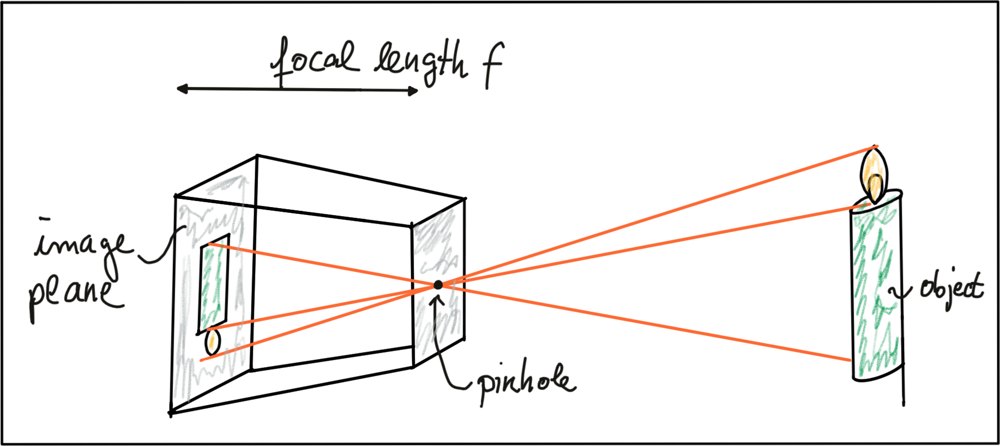

The photosensitive surface on the left is called the image plane whereas the pinhole is called the camera center. The distance between the camera center and the image plane is called the focal length f.

A point P on the object of interest can be mapped to a point P’ on the image plane by casting a beam through the center of projection until it hits the image plane as shown in the figure below.

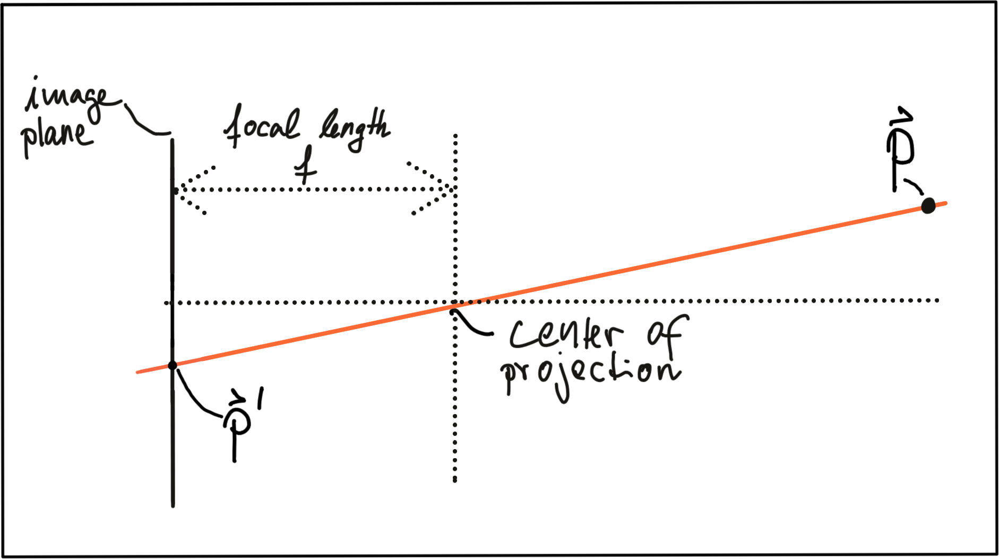

In three-dimensional space, the relation between P and P′ is expressed by the following equations:

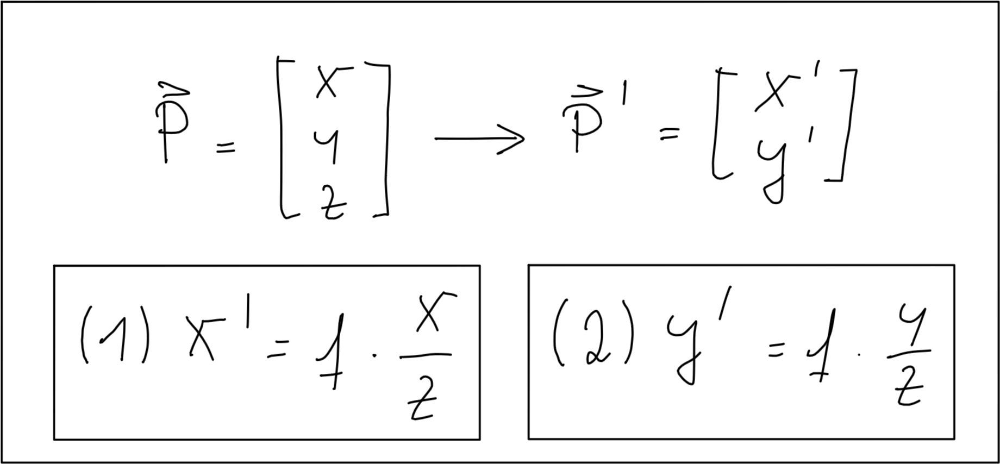

Based on these equations, we are able to compute the 2D position of an object on the image plane, given the 3D position of the object in space as well as the focal length of the camera. Note however that the resulting coordinates x’ and y’ are metrical coordinates and not pixel positions yet.

The problem with pinhole cameras is that the amount of light passing through the pinhole is not sufficient to generate a decent image on an image sensor. If one were to increase the amount of light by widening the pinhole opening as shown in the figure below, rays of light from other parts of the object of interest would superimpose each other, leading to a blurring effect: The larger the pinhole, the brighter the image but at the same time, the more severe the blurring of the object on the image plane would be.

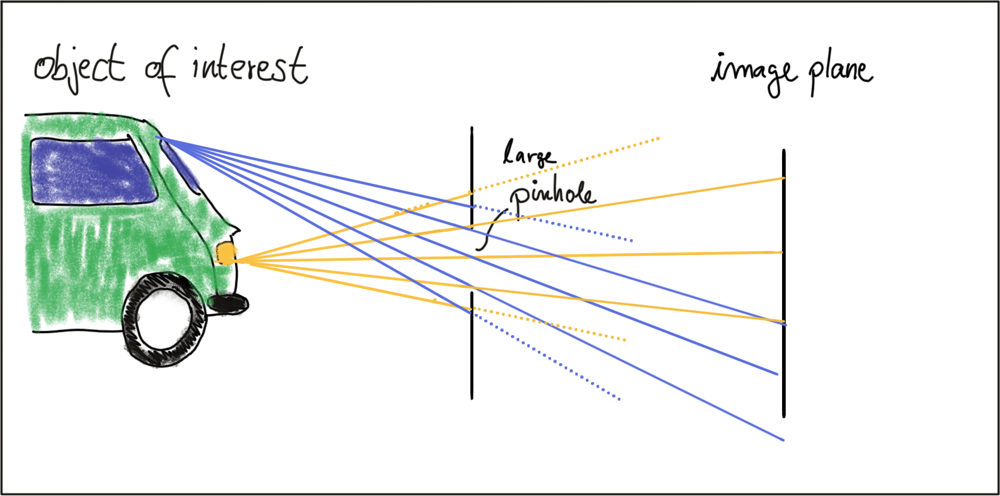

One way to solve this problem is use a lens, which is able to capture multiple rays of light that emanate from the same point on the object of interest. So let’s look at **lenses** next.

### b) Lenses and Aperture

A properly sized and positioned lens refracts all rays of light that emanate from a point P1 on an object in space such that they converge to a single point p_1' in the image plane. Rays of light passing through the lens center are not refracted however, they continue on as a straight line until they intersect the image plane.

Points on the object that are closer or farther away, such as P_2, appear out of focus on the image plane, because the set of light rays emanating from them does not converge in a point but rather in a circle with a finite radius instead. This blurry circle is usually referred to as circle of confusion (COF). To reduce blurring, an aperture can be used, which is a concentric opening of usually adjustable size placed directly behind the lens. The following figure illustrates the principle:

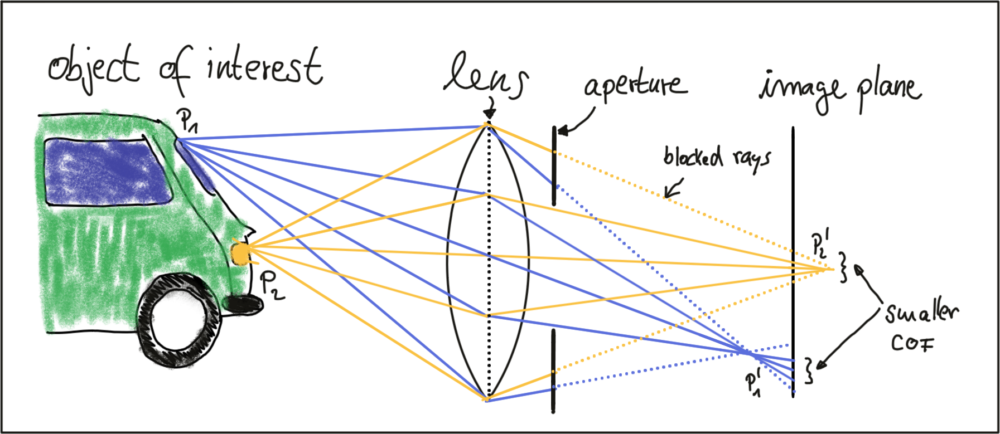

By reducing the diameter of the **aperture**, light rays passing through the lens on the outer edges are blocked, which reduces the size of the COF on the image plane. It can easily be seen that a smaller aperture results in reduced blurring, but at the expense of low light sensitivity. The larger the aperture, the more light rays are focussed onto the image area, resulting in brighter images with a better signal-to-noise ratio.

So how can we compute where an object in space will appear in the image? Given a 3D point in space, its 2D position on the image plane after passing through a lens can be computed similar to the pinhole camera. In practice, lenses introduce distortion into images, depending on the lens type. The distortion most relevant to practice is called “**radial distortion**”. It is caused by the focal length of the lens not being uniform over its diameter. Therefore, the magnification effect of the lens changes depending on the distance between the camera center (the optical axis) and the ray of light passing through the lens. If the magnification increases the resulting distortion effect is called "**pin cushion distortion**". It it decreases, it is called "**barrel distortion**" instead. Barrel distortions usually occur, when wide-angle lenses are used. In the figure below, both distortion types are illustrated.

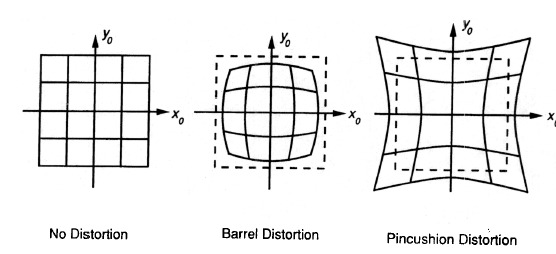

When extracting information from camera images, many applications seek to draw conclusions on the spatial location of objects of interest (e.g. vehicles). To get there, the distortion effect of the lens must be removed or at least mitigated. The relevant process is called calibration. For each camera-lens-setup, a calibration procedure must be performed so the distortion parameters can be individually computed. This is usually done by taking a set of pictures of well-known objects such as planar checkerboard patterns, from whose known geometry all lens and image sensor parameters can be robustly derived. The process of removing distortions from a camera image is called ***rectification***. In the image below, the calibration setup used to rectify most of the images in this course is shown. It can easily be seen that lines at both left and right are distorted significantly.

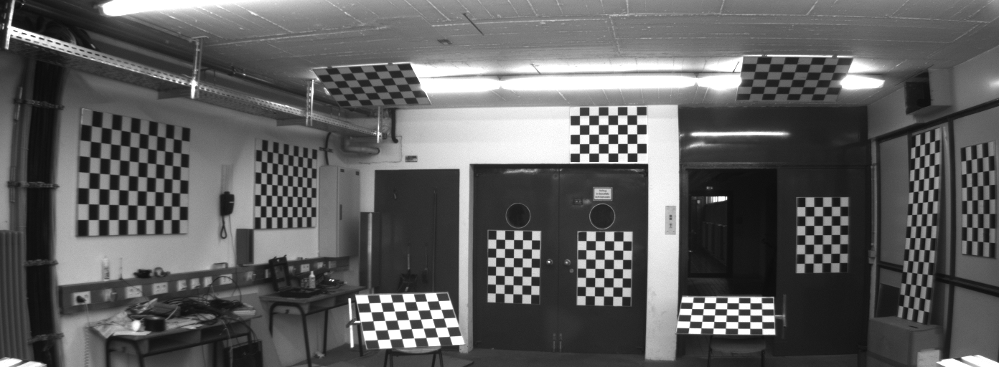

It is beyond the scope of this course however to go into the details of distortion correction. Most of the images you will be using are already free of lens distortion. When using your own camera setup however, a calibration procedure must be performed when precise measurements and a spatial reconstruction of objects is the goal.

As mentioned before, the projection of points in 3D space onto the image plane does not directly correspond to what we see in actual digital images, which are made up of thousands of picture elements or pixels. To understand how images can be expressed in discrete pixels, we need to take a closer look at the above-mentioned camera model once more. In the figure below, the camera center is shown with a position O in space along with its own coordinate system with axes i, j and k, where k is pointing into the direction of the image plane. The position C′ where k intersects the image plane is called the principal point and represents the center of the image coordinate system.

The first step after projecting a point P in space onto the image plane is thus to subtract the principal point coordinates so that the discrete image has its own coordinate system centered in e.g. the lower left corner of the image plane

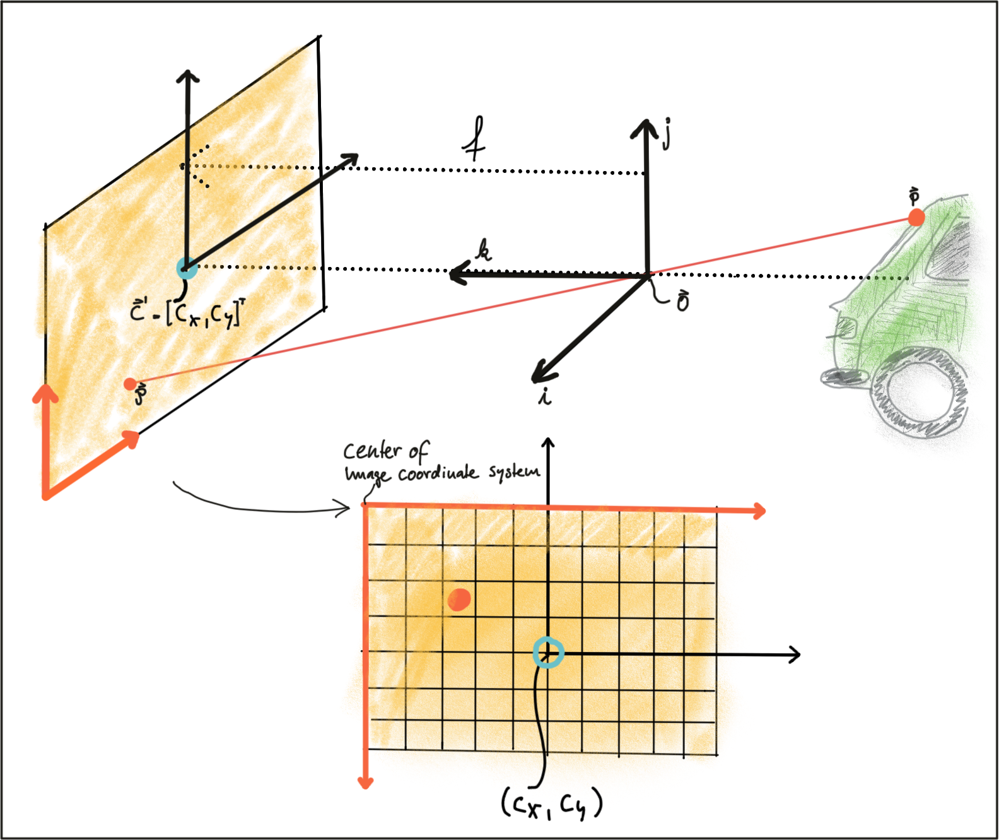

The second step in the transformation process is to move from metric to pixel coordinates. To do so, we can use parameters k and l provided by the calibration procedure which convert meters to pixels and which can be easily integrated into the projection equations as seen below. Note that in image coordinates, the y-axis has its origin in the upper-left corner and is pointing downwards.

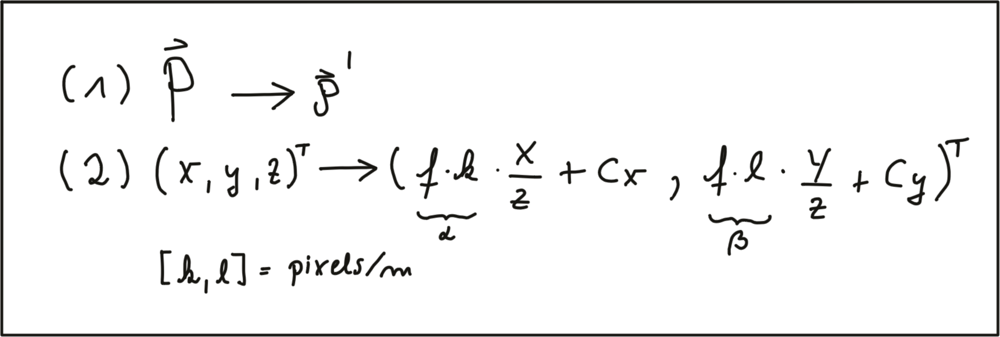

In a later section of this course, we will be mapping Lidar 3D points into the camera image. To do so, we will make use of these equations. Specifically, the product of focal width f and k and l respectively (also termed alpha and beta) will be used in a calibration matrix to simplify the mapping operation significantly.

One final note on image rectification: In many applications (e.g. feature tracking) it makes sense to process the original image to avoid interpolation errors when the rectified image is computed and transformed pixels do not fall exactly onto the center of a discrete pixel in the rectified image but close to the border to another pixel instead. In such a case, it is advisable to locate the features in the unmodified original image and then transform the resulting coordinates using the equations above. When using deep learning based on a set of trained weights, it makes sense to rectify the image first before feeding it to a network - if we would use the original image, distortions (such as from a fish-eye lens) would lead to detection errors as networks are usually trained on a distortion-free image set.

### c) Imagers and Bayer Pattern

In this last section, you will learn how rays of light with a certain wavelength are converted into color pixels that can be stored digitally.

When an image is captured by a camera, light passes through the lens and falls on the image sensor. This sensor consists of light sensitive elements that register the amount of light that falls on them and convert it into a corresponding number of electrons. The more light, the more electrons are generated. Once the exposure time is complete, the generated electrons are converted into a voltage, which is finally transformed into a discrete number by means of an A/D-converter.

Currently, there are two main image technologies, which are CCD (Charge-Coupled Device) and CMOS (Complementary Metal-oxide Semiconductor). Both technologies convert electrons into voltage and are inherently color blind, as they can not distinguish the different wavelengths which generate the electrons. To enable color vision, tiny filter elements (also micro-lenses) are placed in front of each pixel which only allow a certain wavelength to pass through. One common way to map wavelength to color is to arrange the filter elements in an RGB (Red, Green, Blue) pattern to allow the primary colors to pass through individually, which gives us three individual images - one for each primary color.

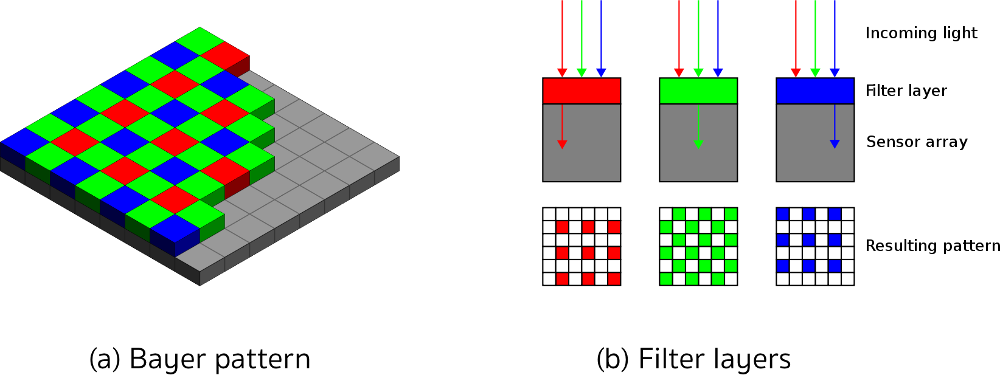

Mixed in different combinations, RGB values can produce most of the colors visible to the human eye. When each discrete color value is coded with 8bits (i.e. 256 values), a total of 16.7 million different colors can be created with the RGB filter concept. The most common way of arranging the RGB filters is called a Bayer pattern, which has alternating rows of red-green and green-blue filters. Since the human eye is more sensitive to green than to red or blue, the Bayer array has twice as many green color filters. When processing color images in a computer vision application, all three RGB layers are available and it has to be decided which color layers to use. If processing power is limited, the different channels are combined into a gray scale image. In the upcoming section on computer vision, you will be introduced to the OpenCV computer vision library. You can take a look at the conversion formula to get from RGB to grayscale which is used in the method cvtColor [here](https://docs.opencv.org/3.1.0/de/d25/imgproc_color_conversions.html) 

#### CCD vs. CMOS

In a **CCD sensor**, the electrons collected in each picture element are transferred from the chip through a single or only a few output nodes. The charges are then converted to voltage levels, buffered, and sent out as an analog signal. This signal is then amplified and converted to discrete numbers using an A/D-converter outside the sensor. Originally, CCD technology has had several advantages compared to CMOS, such as higher light sensitivity and less noise. In recent years, however, these differences have all but disappeared. The major disadvantages of CCD are a higher production price and a higher power consumption (up to 100x more than CMOS) , which usually leads to heat issues in the camera.

**CMOS sensors** were originally used for machine vision applications, but the image quality was poor due to their inferior light sensitivity. With modern CMOS sensors however, both quality and light sensitivity have significantly increased. The CMOS technology has several advantages: Unlike CCD, CMOS chips incorporate amplifiers and A/D-converters, which brings a huge cost advantage. With CCD, those components are located outside of the chip. CMOS sensors also have a faster data readout, lower power consumption, higher noise immunity, and a smaller system size. In automotive applications, almost all cameras use CMOS sensors because of these advantages. The camera setup used for recording most of the image sequences in this course can be found [here](http://www.cvlibs.net/datasets/kitti/setup.php)

#### Review

##### What is the focal length of a camera?
The focal length is the distance between the center of the camera and its focus point.

##### How can blurring of objects in an image be reduced?
1. By introducing an aperture to reduce the diameter of the circle of confusion.
2. By moving the camera (or object) to a position such that the focus points of all rays emanating from the object are on the image plane.

##### What is the principal point and how does it relate to pixel coordinates?
The principal point is the coordinate on the image plane where the optical axis of the camera intersects the image plane. In order to compute the pixel position of a point projected onto the image plane, the principal point location is used to shift the image coordinate system to the lower (or upper) left corner of the image plane.

##### Why does the Bayer pattern put more emphasis on green filters than on red or blue filters?
The Bayer pattern uses twice as many green pixels as the human (daylight) vision is more sensitive to green light.

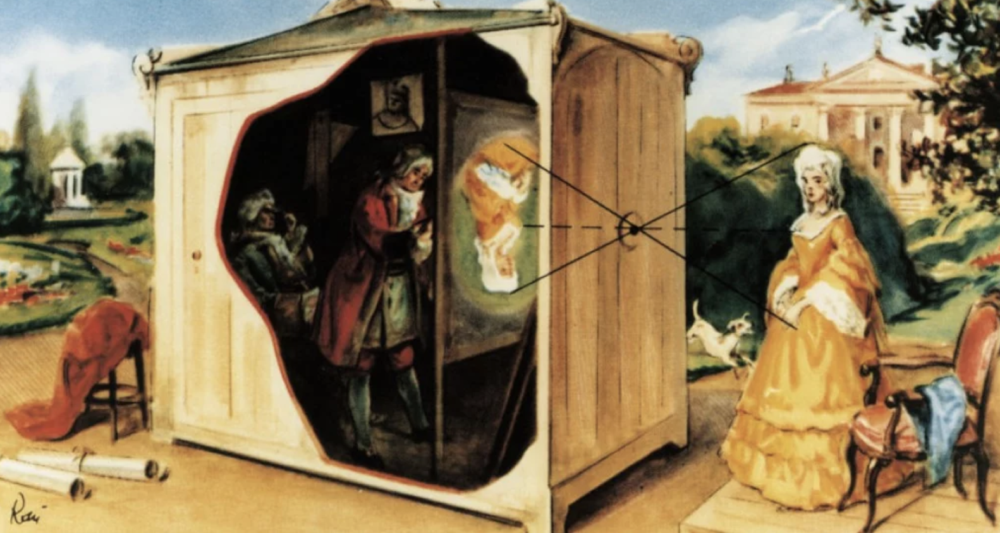

### d) Camera Technology at MBRDNA

#### What types of lenses do self-driving cars use?
* Wide-angle
* narrow-angle
It is also improtant to have high light sensitivity, large aperture

#### What types of chips do the camera use?
* 1-8 Megapixles
* The resolution is not important to self-driving cars
* The light sensitivity is more important

#### What does it mean for a camera to be "automotive-grade"?
* Packing: ruggedness, durability of the entire setup, meaning the integration of the chip and the lens won't decalibrate quickly due to various temperatures and conditions

#### What resolution is necessary for robotic cameras?
* 1-8 Megapixles
* Pixels are larger, meaning more photons fall into one pixel
* It is not the resollution but the sensitivity more important

#### Dose it make sense to have multiple cameras on a robot or autonomous vehicle?
* Different use-case
* Different FoV for far and near objects
* Different chips that cover different spectrums, for night-time driving, for high dynamic range

#### How reliable is camera-only depth detection?
* Reliable only in near-field

#### How do you stitch together images from different cameras on the same vehicle?
* We do not do stitching but by calibrating different cameras wrt the common time frame/global frame

#### For what tasks do cameras excel?
* Greater resolution: recognition
* Traffic light/signs

#### What conditions present challenges?
* Night-time driving: still not good enough
* Measuring Depth
* Due to the high readial resolution at cross-traffic, but difficult to measure on-coming vehicle's speed

### e) The [OpenCV](https://opencv.org/) Computer Vision Library

#### OpenCV Library Overview

The ***core*** module is the section of the library that contains all of the basic object types and their operations. To use the library in your code, the following header has to be included:

```c++
#include "opencv2/core/core.hpp"
```

The ***highgui*** module contains user interface functions that can be used to display images or take simple user input. To use the library in your code, the following header has to be included:

```c++
#include "opencv2/highgui/highgui.hpp"
```

In this project, basic functions such as `cv::imshow` will be used to display images in a window.

The ***imgproc*** (image processing) module contains basic transformations on images, such as **image filtering**, **geometric transformations**, **feature detection and tracking**. To use the library in your code, the following header has to be included:

```c++
#include "opencv2/imgproc/imgproc.hpp"
```

The ***features2d*** module contains algorithms for **detecting**, **describing**, and **matching** keypoints between images. To use the library in your code, the following header has to be included:

```c++
#include "opencv2/features2d/features2d.hpp"
```

#### The OpenCV Matrix Datatype

The basic data type in OpenCV to store and manipulate images is the `cv::Mat` datatype. It can be used for arrays of any number of dimensions. The data stored in `cv::Mat` is arranged in a so-called `raster scan order`. For a two-dimensional array (such as a grayscale image), this means that the data is organized into rows, and each row appears one after the other. A three-dimensional array (e.g. a color image) is arranged in planes, where each plane is filled out row by row, and then the planes are packed one after the other. To see how this works, let us look into the `cv::Mat` datatype more deeply:

The data inside a `cv::Mat` variable can be either single numbers or multiple numbers. In the case of multiple numbers (e.g. represented by `cv::Scalar`), the matrix is referred to as a multichannel array. There are several ways to create and initialize a `cv::Mat` variable. The `create_matrix.cpp` file in the workspace below illustrates one way how this can be done.

#### Manipulating Matrices

##### Create a 2D image

```c++
// create matrix
int nrows = 480, ncols = 640;
cv::Mat m1_8u;
m1_8u.create(nrows, ncols, CV_8UC1); // two-channel matrix with 8bit unsigned elements
m1_8u.setTo(cv::Scalar(255));        // white

// show result
string windowName = "First steps in OpenCV (m1_8u)";
cv::namedWindow(windowName, 1); // create window
cv::imshow(windowName, m1_8u);
cv::waitKey(0); // wait for keyboard input before continuing
```

##### Create a 3D image

```c++
cv::Mat* m3_8u = new cv::Mat();
m3_8u->create(nrows, ncols, CV_8UC3);
m3_8u->setTo(cv::Scalar(255, 0, 0));

string windowName = "First steps in OpenCV (m3_8u)";
cv::namedWindow(windowName, 1); // create window
cv::imshow(windowName, *m3_8u);
cv::waitKey(0); // wait for keyboard input before continuing
```

##### Change Pixels

Now that you can create matrices, let us try to change some of their entries: By using the command `cv::Mat::at<data type>(row, col) = data` the element at the given position can be replaced with data. Please note that the data type you provide to the `at`-function has to match the actual data stored in the matrix you are trying to access.

```c++
// create matrix
int nrows = 480, ncols = 640;
cv::Mat m1_8u;
m1_8u.create(nrows, ncols, CV_8UC1); // two-channel matrix with 8bit unsigned elements
m1_8u.setTo(cv::Scalar(0));          //black

for (int r = 230; r < 250; r++)
{
    // STUDENT TASK : loop over all columns and set matrix elements to 255
    for (int c = 0; c < ncols; c++)
    {
        m1_8u.at<uchar>(r, c) = 255;
    }
}

// show result
string windowName = "First steps in OpenCV";
cv::namedWindow(windowName, 1); // create window
cv::imshow(windowName, m1_8u);
cv::waitKey(0); // wait for keyboard input before continuing
```

#### Loading and Handling Images

The next thing we want to do is to load an image from file. Let us assume that the image resides in the same path as the executable. By calling `cv::imread` we can load the image from file and assign it to a `cv::Mat` variable. Take a look at the following code example to see how a single image can be loaded from file. You can build the code as above, and you can run the code from the virtual desktop using the `load_image_1` executable.
    
```c++
cv::Mat img;
img = cv::imread("../images/img1.png");

// show result
string windowName = "First steps in OpenCV";
cv::namedWindow(windowName, 1); // create window
cv::imshow(windowName, img);
cv::waitKey(0); // wait for keyboard input before continuing
```

Assuming that there are 5 images in total in the code directory (img0005.png - img0009.png) , they can easily be read from file one after the other using string concatenation. The next example shows how the filename can be easily assembled from single elements using string concatenation and the setfill-function, which ensures that the prepending zeros are added to the loop variable before appending it to the filename. You can run the next example using the `load_image_2` executable.

```c++
for (int i = 5; i <= 9; i++)
{

    // create file name
    ostringstream imgNumber;                   // #include <sstream>
    imgNumber << setfill('0') << setw(4) << i; // #include <iomanip>
    string filename = "../images/img" + imgNumber.str() + ".png";

    // load and display image
    cv::Mat img;
    img = cv::imread(filename);
    string windowName = "First steps in OpenCV";
    cv::namedWindow(windowName, 1); // create window
    cv::imshow(windowName, img);
    cv::waitKey(0); // wait for keyboard input before continuing
}
```

Later in the course, we will load and process several images one after the other. It is important to handle large amounts of data in a smart way so that images and other structures are not needlessly copied. Also, we want to flexibly rearrange data as well as delete and append elements on a regular basis. In C++, this can easily be achieved by using vectors. In the following code, a set of images is loaded from file as before and pushed into a dynamic list of type `vector<cv::Mat>`. Then, an iterator is used to loop over the list and display the loaded images one by one.

You can run the code below using the `load_image_3` executable.

```c++
// load images
vector<cv::Mat> imgList;
for (int i = 5; i <= 9; i++)
{
    // create file name
    ostringstream imgNumber;                   // #include <sstream>
    imgNumber << setfill('0') << setw(4) << i; // #include <iomanip>
    string filename = "../images/img" + imgNumber.str() + ".jpg";

    // load image and store it into a vector
    cv::Mat img;
    img = cv::imread(filename);
    imgList.push_back(img); // store pointer to current image in list
}

// display images from the vector
string windowName = "First steps in OpenCV";
cv::namedWindow(windowName, 1); // create window
for (auto it = imgList.begin(); it != imgList.end(); ++it)
{

    // STUDENT TASK : Prevent image 7 from being displayed
    if (it == imgList.begin() + 2) continue;

    // display image
    cv::imshow(windowName, *it);
    cv::waitKey(0); // wait for keyboard input before continuing
}
```

The `auto` keyword is simply asking the compiler to deduce the type of the variable from the initialization, which is much more convenient than writing `vector<cv::Mat>::iterator it` instead. The current image within the loop can be accessed by using the `*it` expression.

Here is a last exercise for you: In the loop of `load_image_3.cpp`, prevent image number 7 from being displayed.

## 3. Collision Detection Basics

### a) The Collision Detection Problem
A ***collision avoidance system*** (CAS) is an active safety feature that warns drivers or even triggers the brake in the event of an imminent collision with an object in the path of driving. If a preceding vehicle is present, the CAS continuously estimates the **time-to-collision** (TTC). When the TTC falls below a lower threshold, the CAS can then decide to either warn the driver of the imminent danger or - depending on the system - apply the vehicle brakes autonomously. For the engineering task you will be completing in this course this means that you will need to find a way to compute the TTC to the vehicle in front.

Let us take a look at the following scene:

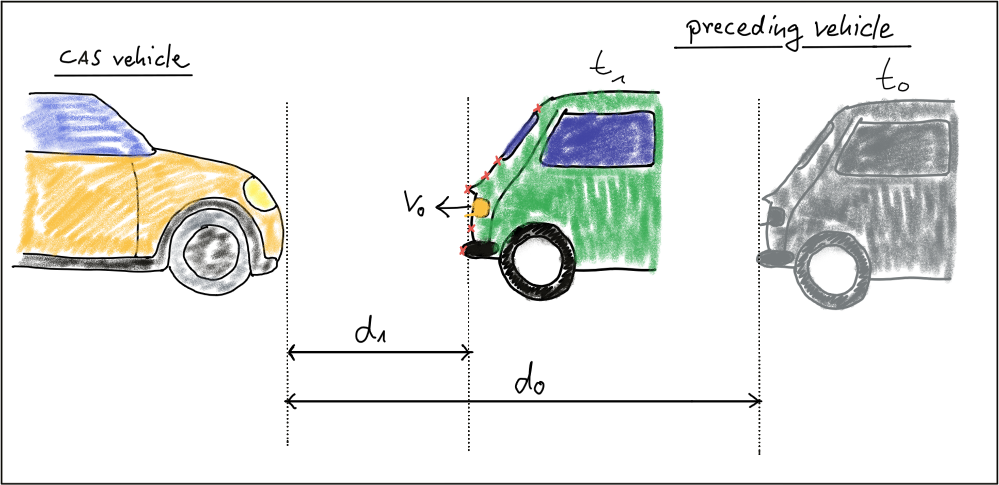

In this traffic scenario, the green vehicle starts to reduce its speed at time t0, which is when the yellow vehicle, equipped with a collision sensor, takes the distance measurement d0. A moment later, at time t1, the green vehicle is considerably closer and a second measurement d1 is taken. The goal now is to compute the remaining TTC so the system can warn the driver of the yellow vehicle or even trigger the brakes autonomously.

Before we can do this however, we need to find a way to describe the relative motion of the vehicles with a mathematical model.

### Constant velocity vs. constant acceleration
To compute the TTC, we need to make assumptions on the physical behavior of the preceding vehicle. One assumption could be that the relative velocity between the yellow and green vehicle in the above figure were constant. This would lead to the so-called constant velocity model (CVM) which is represented by eq. 1 in the following diagram.

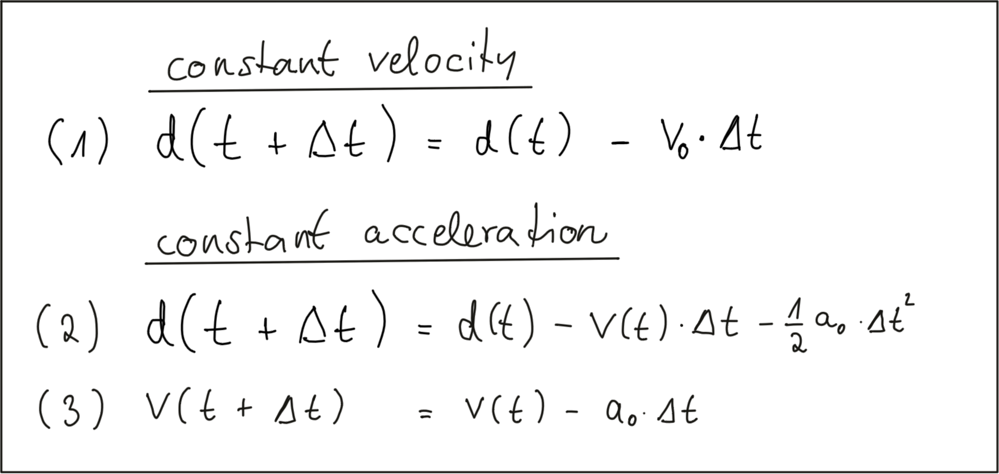

As you can see, the distance to the vehicle at time instant t+Δt is smaller than at time tt, because we subtract the product of a constant relative velocity v0 and time Δt. From an engineering perspective, we would need a sensor capable of measuring the distance to the preceeding vehicle on a precisely times basis with a constant dt between measurements. This could very well be achieved with e.g. a Lidar sensor.

Especially in dynamic traffic situations where a vehicle is braking hard, the CVM is not accurate enough however, as the relative velocity between both vehicles changes between measurements. In the following figure, the approaching vehicle is shown at three time instants with increasing velocity.

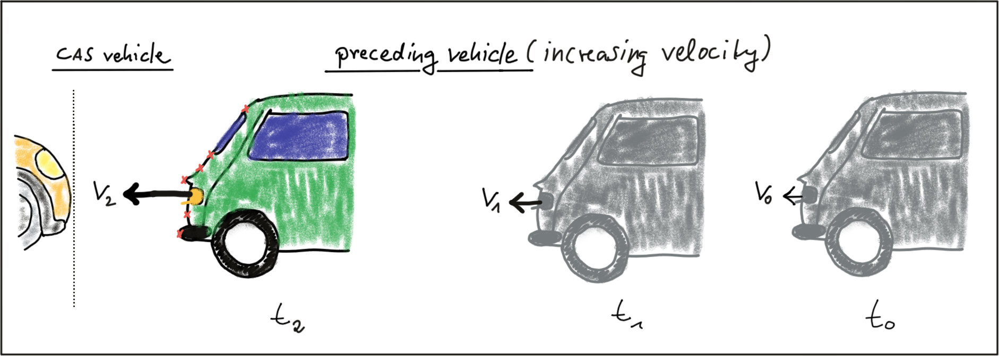

We can thus expand on our CVM by assuming velocity to be a function of time and subtract a second term in eq. 2 which is the product of a constant acceleration and the squared time dt between both measurements. Eq. 3 displays velocity as a function of time, which is also dependent on the constant acceleration we used in eq. 2. This model is referred to as ***constant acceleration model*** (CAM) and it is commonly used in commercially available collision detection systems. On a side note, if we were using a radar sensor instead of a Lidar, a direct measurement on velocity could be taken by exploiting a frequency shift in the returning electromagnetic wave due to the Doppler effect. This is a significant advantage over sensors such as Lidar, where velocity can only be computed based on (noisy) distance measurements.

In this course, we will be using a CVM instead of the CAM as it is much simpler to handle with regard to the math involved and with regard to the complexity of the programming task ahead of you. For small instances of dt we will assume that the CVM model is accurate enough and that it will give us a decent estimate of the TTC. Should you be involved in building a commercial version of such a system at a later stage in your career however, keep in mind that you should be using a ***constant acceleration model instead***.

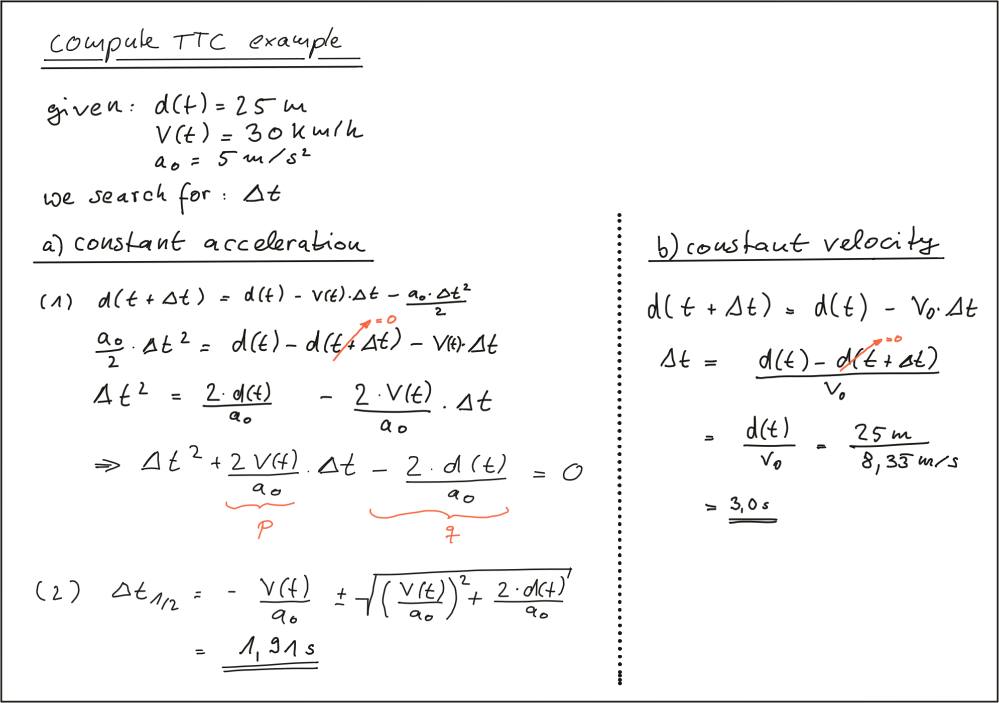


### b) Estimating TTC with Lidar

#### The Math Behind Time-to-Collision (TTC)
In the following, let us assume that our CAS-equipped vehicle is using a Lidar sensor to take distance measurements on preceding vehicles. The sensor in this scenario will give us the distance to the closest 3D point in the path of driving. In the figure below, the closest point is indicated by a red line emanating from a Lidar sensor on top of the CAS vehicle.

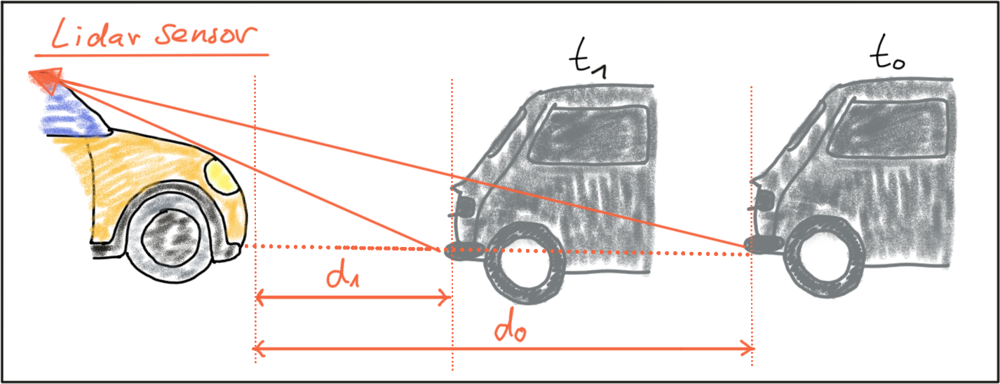

Based on the model of a constant-velocity we discussed in the last section, the velocity v0 can be computed from two successive Lidar measurements as follows:

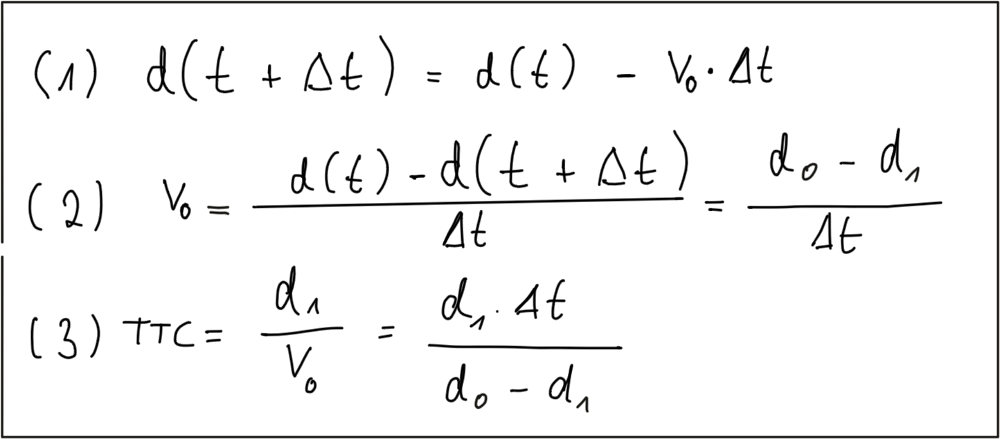

Once the relative velocity v0 is known, the time to collision can easily be computed by dividing the remaining distance between both vehicles by v0. So given a Lidar sensor which is able to take precise distance measurements, a system for TTC estimation can be developed based based on a CVM and on the set of equations shown above. Note however that a radar sensor would be the superior solution for TTC computation as it can directly measure the relative speed, whereas with the Lidar sensor we need to compute v0 from two (noisy) distance measurements.

#### Preparing the Lidar Point Cloud
The following image shows a Lidar point cloud as an overlay over a camera image taken in a highway scenario with a preceding vehicle directly in the path of driving. Distance to the sensor is color-coded (green is far away, red is close). On the left side, a bird-view perspective of the Lidar points is shown as well.

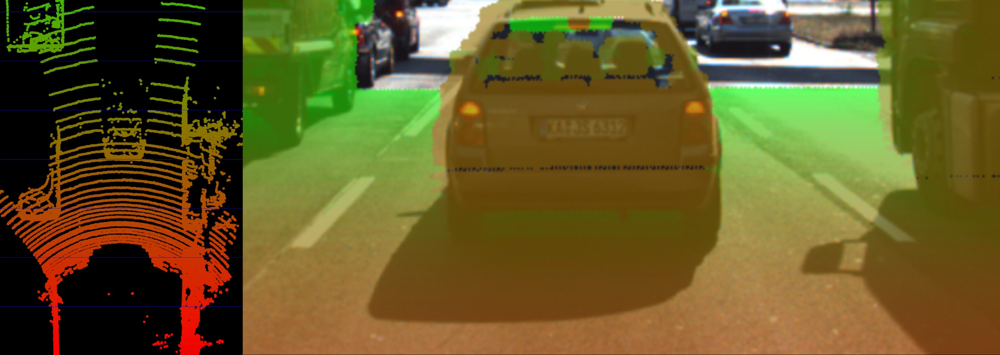

As can easily be seen, the Lidar sensor provides measurements on the vehicles as well as on the road surface. Also, some 3D points in the camera image do not seem accurate when compared to their surrounding neighbors. Especially the points near the roof of the preceding vehicle differ in color from the points on the tailgate.

As measurement accuracy is correlated to the amount of light reflected from an object, it makes sense to consider the reflectiveness r of each Lidar point which we can access in addition to the x, y and z coordinates. The image below highlights high reflectiveness with green, whereas regions with low reflectiveness are shown as red. An analysis of the associated reflectivity of the point cloud shows that such deviations often occur in regions with reduced reflectiveness.

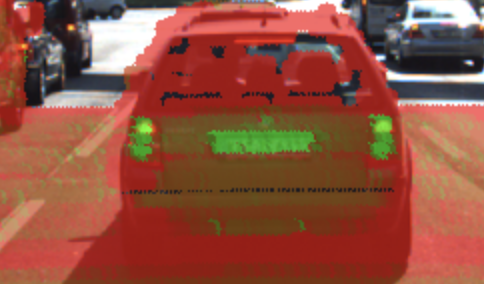

In order to derive a stable TTC measurement from the given point cloud, two main steps have to be performed:

1. Remove measurements on the **road surface**
2. Remove measurements with **low reflectivity**

In the figure below, Lidar points are shown in a top-view perspective and as an image overlay after applying the filtering. After removing Lidar points in this manner, it is now much easier to derive the distance d(t) to the preceding vehicle.

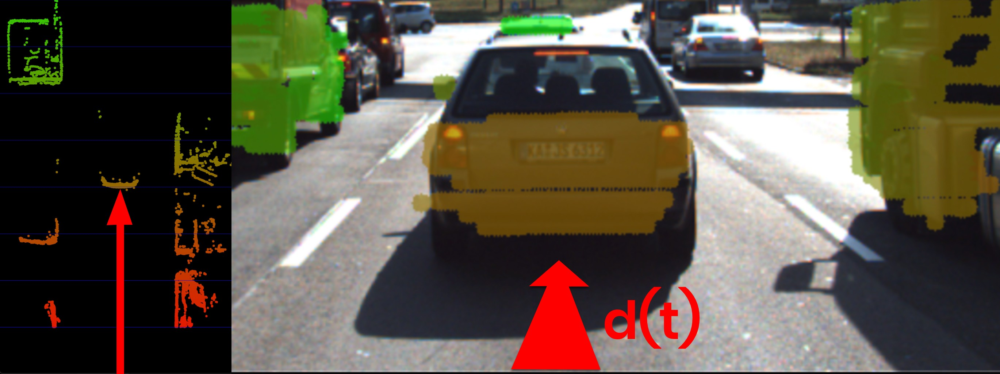

In a later lesson, you will learn how to project Lidar points into the camera image and how to perform the removal procedure as seen in the above examples. For now, let us assume that for each time step dt, the Lidar sensor would return the distance d(t+dt) to the preceding vehicle.

#### Computing TTC from Distance Measurements
In the code examples in this course, Lidar points are packaged into a data structure called LidarPoints. As seen below, the structure consists of the point coordinates x (forward), y (left) an z (up) in metric coordinates and of the point reflectivity r on a scale between 0 and 1 (high reflectivity).

```c++
struct LidarPoint { // single lidar point in space
    double x, y, z; // point position in m
    double r; // point reflectivity in the range 0-1
};
```

In order to compute the TTC, we need to find the distance to the closest Lidar point in the path of driving. In the figure below, Lidar measurements located on the tailgate of the preceding vehicle are measured at times t0(green) and t1(red). It can be seen, that the distance to the vehicle has decreased slightly between both time instants.

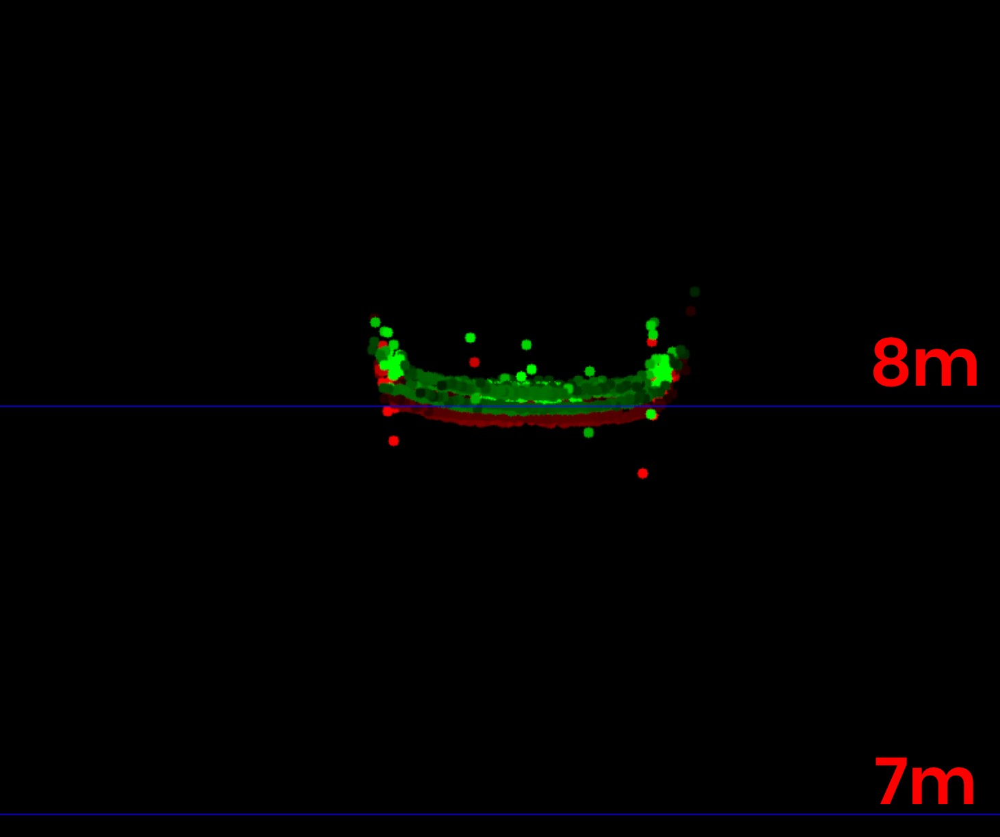

The following code searches for the closest point in the point cloud associated with t0(`lidarPointsPrev`) and in the point cloud associated with t1(`lidarPointsCurr`). After finding the distance to the closest points respectively, the TTC is computed based on the formula we derived at the beginning of this section.

```c++
void computeTTCLidar(std::vector<LidarPoint> &lidarPointsPrev, 
                     std::vector<LidarPoint> &lidarPointsCurr, double &TTC)
{
    // auxiliary variables
    double dT = 0.1; // time between two measurements in seconds

    // find closest distance to Lidar points 
    double minXPrev = 1e9, minXCurr = 1e9;
    for(auto it=lidarPointsPrev.begin(); it!=lidarPointsPrev.end(); ++it) {
        minXPrev = minXPrev>it->x ? it->x : minXPrev;
    }

    for(auto it=lidarPointsCurr.begin(); it!=lidarPointsCurr.end(); ++it) {
        minXCurr = minXCurr>it->x ? it->x : minXCurr;
    }

    // compute TTC from both measurements
    TTC = minXCurr * dT / (minXPrev-minXCurr);
}
```

Even though Lidar is a reliable sensor, erroneous measurements may still occur. As seen in the figure above, a small number of points is located behind the tailgate, seemingly without connection to the vehicle. When searching for the closest points, such measurements will pose a problem as the estimated distance will be too small. There are ways to avoid such errors by ***post-processing*** the point cloud, but there will be no guarantee that such problems will never occur in practice. It is thus a good idea to perform a more robust computation of minXCurr and minXPrev which is able to cope with a certain number of outliers (in the final project, you will do this) and also look at a second sensor which is able to compute the TTC, such as the camera.





### c) Estimating TTC with a Camera

#### Measuring TTC without distance
Monocular cameras are not able to measure metric distances. They are passive sensors that rely on the ambient light which reflects off of objects into the camera lens. It is thus not possible to measure the runtime of light as with Lidar technology.

To measure distance, a second camera would be needed. Given two images taken by two carefully aligned cameras (also called a stereo setup) at the same time instant, one would have to locate common points of interest in both images (e.g. the tail lights of the preceding vehicle) and then triangulate their distance using camera geometry and perspective projection. For many years, automotive researchers have developed stereo cameras for the use in ADAS products and some of those have made it to market. Especially Mercedes-Benz has pioneered this technology and extensive information can be found [here](http://www.6d-vision.com/). With more advanced ADAS products and with autonomous vehicles however, stereo cameras have started to disappear from the market due to their package size, the high price and the high computational load for finding corresponding features.

Despite those limitations of the mono camera, let us see if there is a way to compute TTC without the need to measure distance. Let us consider the constant velocity motion model we introduced in a previous section of this course and think about a way to replace the metric distances d with something the camera can measure reliably, such as pixel distances directly on the image plane. In the following figure, you can see how the height HH of the preceding vehicle can be mapped onto the image place using perspective projection. We can see that the same height HH maps to different heights h0 and h1 in the image plane, depending on the distance d0 and d1 of the vehicle. It is obvious that there is a geometric relation between h, H, d and the focal length f of the pinhole camera - and this is what we want to exploit in the following.

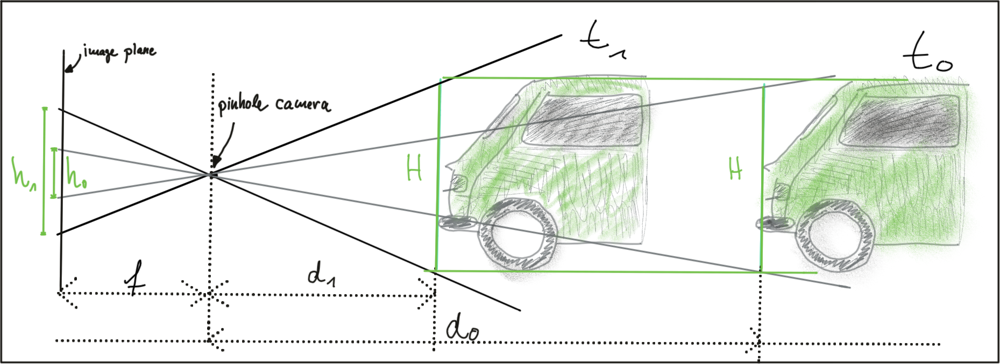

Let us take a look at the following set of equations:

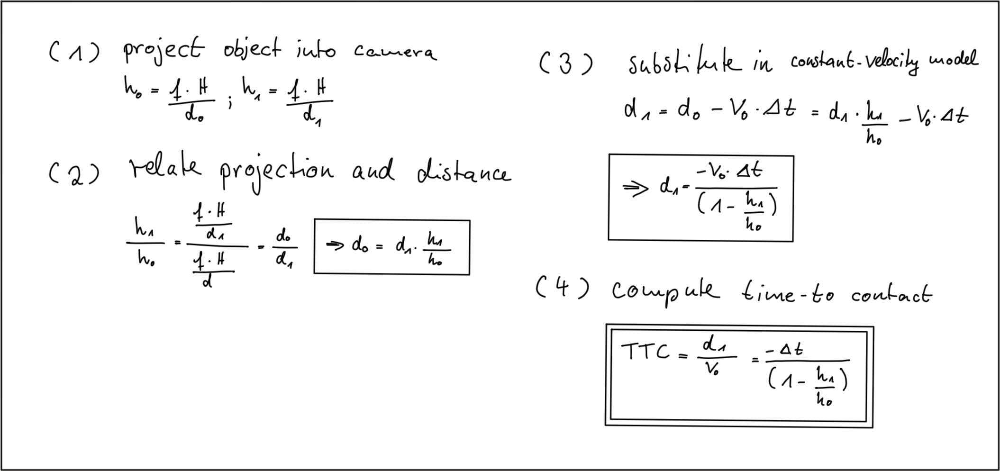

In (1) we use the focal length of the camera and a distance measurement d0 performed at time t0 to project the height H of the vehicle onto the image plane and thus to a height h0 in pixels. The same is done at time t1, leading to a projected height h1.

In (2), we compute the ratio of the relative heights h0 and h1. As both H and f are cancelled out, we can observe a direct relation between relative height hh and absolute metric distance dd. We can thus express the distance to the vehicle d0 as the product of d1 and the ratio of relative heights on the image plane.

In (3), we substitute d0 in the equation for constant velocity and solve for d1, which is now dependent on the constant relative velocity v0, on the time between measuring d0 and d1 and on the ratio of relative heights on the image plane.

In (4), the TTC is computed as the ratio of remaining distance to impact, which is d1, and the constant velocity v_0v 0. As we can easily see, the TTC now only consists of Δt, h0 and h1. Thus, it is possible to measure the time to collision by observing relative height change on the image sensor. Distance measurements are not needed and we can thus use a mono camera to estimate the time-to-collision by observing changes in relative height (also called scale change) directly in the image.

#### The Problem with Bounding Box Detection
In the figure below, a neural network has been used to locate vehicles in successive images of a monocular camera. For each vehicle, the network returns a bounding box, whose width and/or height could in principal be used to compute the height ratio in the TTC equation we derived in the last section.

When observed closely however, it can be seen that the bounding boxes do not always reflect the true vehicle dimensions and the aspect ratio differs between images. Using bounding box height or width for TTC computation would thus lead to significant estimation errors.

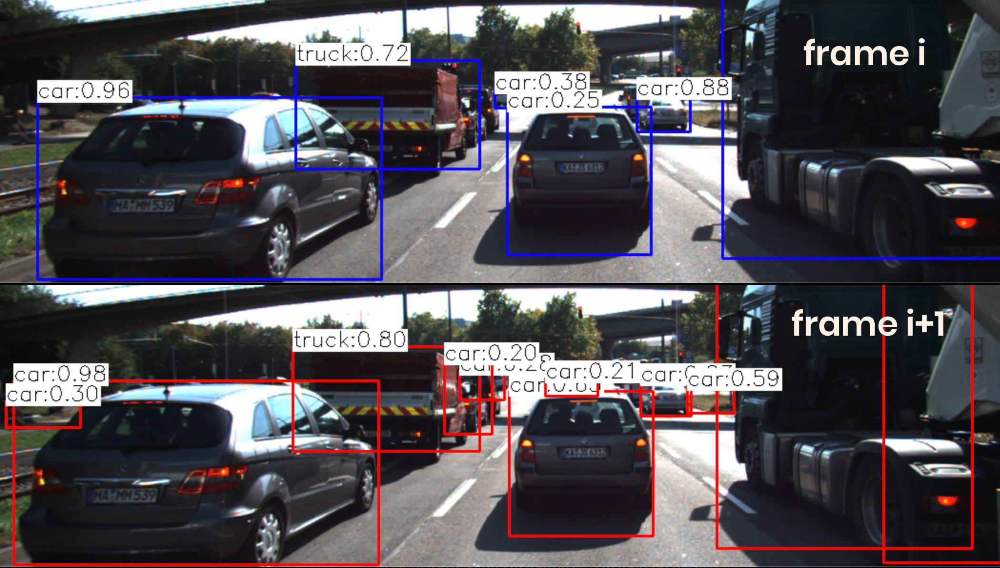

In most engineering tasks, relying on a single measurement or property is not reliable enough. This holds especially true for safety-related products. Therefore, we want to consider wether there are further properties of vehicles and objects we can observe in an image.

#### Using Texture Keypoints Instead
Instead of relying on the detection of the vehicle as a whole we now want to analyze its structure on a smaller scale. If if were possible to locate uniquely identifiable keypoints that could be tracked from one frame to the next, we could use the distance between all keypoints on the vehicle relative to each other to compute a robust estimate of the height ratio in out TTC equation. The following figure illustrates the concept.

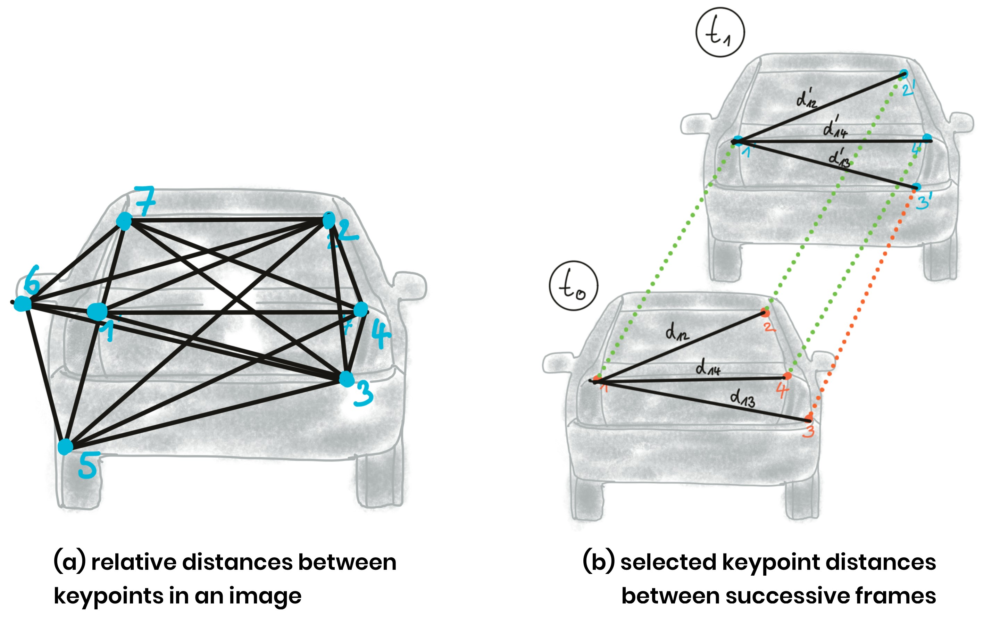

In (a), a set of keypoints has been detected and the relative distances between keypoints 1-7 have been computed. In (b), 4 keypoints have been matched between successive images (with keypoint 3 being a mismatch) using a higher-dimensional similarity measure called ***descriptor*** (more about that in the next lesson). The ratio of all relative distances between each other can be used to compute a reliable TTC estimate by replacing the height ratio h1/h0 with the mean or median of all distance ratios dk/dk′.

The following figure shows several example of relative distances between keypoints as an overlay over a highway driving scene (only the preceding vehicle is highlighted).

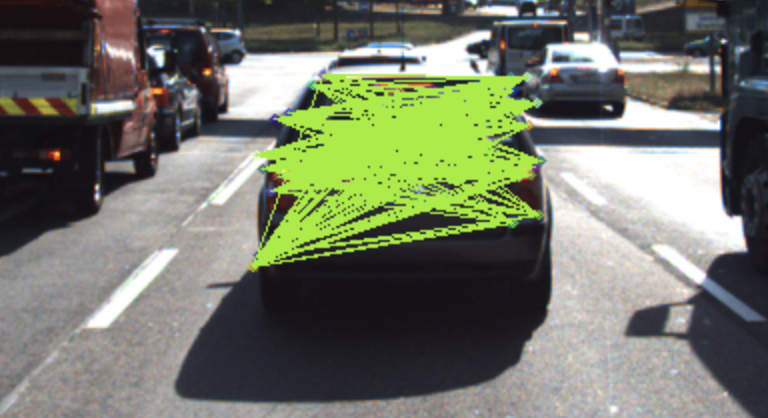

#### Computing TTC from Relative Keypoint Distances
In the code examples in this course, matching keypoints between images are packaged into an OpenCV data structure called `cv::DMatch`. The structure elements we will be using in this course are `queryIdx`, which is the index of a keypoint in the current frame, and `trainIdx`, which is the index of the matched keypoint in the previous frame.

All matched keypoints are stored in a dynamic list, which is then passed to a function called `computeTTCCamera`, which returns the time-to-collision for each object in the scene. Let us take a look at this function in the following.

1. Find the bounding box of the preceding vehicle
2. A set of keypoints for every frame
3. Match keypionts in successivbe frames
4. Compute the relative distance between keypoints and find the median

Imagine a set of associated keypoint between two successive frames which contain a large number of mismatches. Computing the mean distance ratio as in the function we just discussed would presumably lead to a faulty calculation of the TTC. A more robust way of computing the average of a dataset with outliers is to use the **median** instead. In the code below, replace `meanDistRatio` with a variable `medianDistRatio` and do not forget to consider both an even and an odd number of values in the vector `distRatios`.


### d) Course Structure

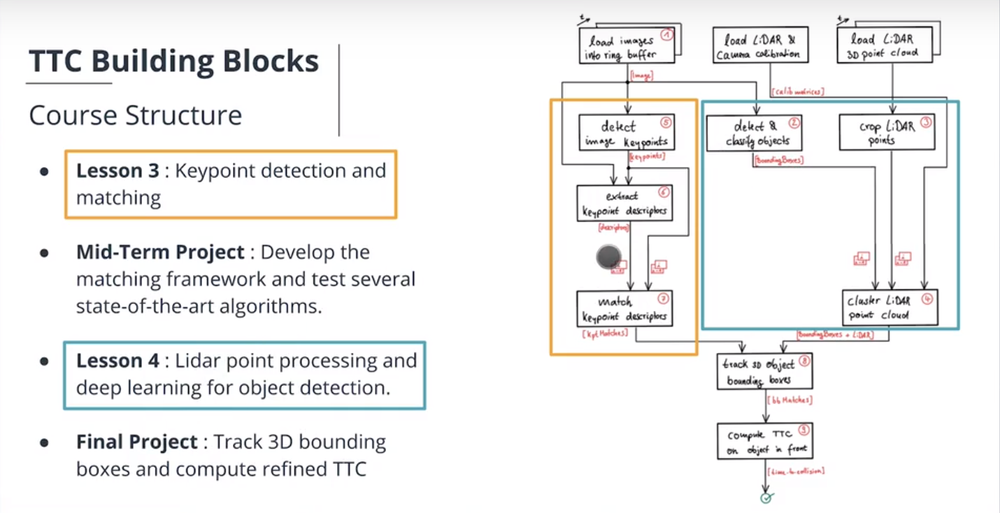

### e) Early Fusion vs. Late Fusion

* Raw Data
* Individual Results
* Mixed Approch